In [1]:
import json
import pandas as pd
from PIL import Image
from collections import defaultdict

In [2]:
prompt_results_df = pd.read_csv('C:/Users/neals/Desktop/practicum/prompt_results_classification.csv')
prompt_results_df['prompt'] = prompt_results_df['prompt'].fillna('')
prompt_results_df.prompt.unique()
context_df = prompt_results_df[prompt_results_df['prompt']=='']
context_df.head()

,image_id,image_file,image_path,prompt,generated_text,category,processing_time
0,1,P0003_0.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of a parking lot with several y...,1,2.130118
17,2,P0003_1.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.085106
34,3,P0003_2.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of a road with a yellow school ...,1,1.149868
51,4,P0003_3.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.006406
68,5,P0003_4.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.092633


In [3]:
dataset_dir = 'E:/datasets'
dataset_name = 'DOTA_dataset_512'
coco_dir = f'{dataset_dir}/{dataset_name}'
coco_file = f'{coco_dir}/val_coco.json'
coco_file = f'{coco_dir}/YOLO_coco_results_annots.json'

with open(coco_file, 'r') as f:
    coco_json = json.load(f)

category_map = {cat['id']:cat['name'] for cat in coco_json['categories']}
annotation_df = pd.DataFrame(coco_json['annotations'])
annotation_df['category'] = annotation_df['category_id'].map(category_map)
annotation_df.head()

,id,image_id,category_id,area,bbox,score,iscrowd,category
0,1,1,2,6136.0,"[210, 452, 104, 59]",0.878193,0,large-vehicle
1,2,1,2,3024.0,"[196, 381, 63, 48]",0.876341,0,large-vehicle
2,3,1,2,3731.0,"[321, 269, 41, 91]",0.867147,0,large-vehicle
3,4,1,2,2961.0,"[186, 343, 63, 47]",0.866993,0,large-vehicle
4,5,1,2,3649.0,"[287, 267, 41, 89]",0.866044,0,large-vehicle


In [4]:
category_agg = annotation_df.groupby('image_id')['category'].agg(lambda x: list(set(x))).reset_index()
category_agg.rename(columns={'category': 'category_list'}, inplace=True)
# Flatten the lists and find unique values
unique_values = pd.Series([item for sublist in category_agg['category_list'] for item in sublist]).unique()

unique_values

array(['large-vehicle', 'small-vehicle', 'storage-tank', 'ship', 'harbor',
       'ground-track-field', 'soccer-ball-field', 'baseball-diamond',
       'swimming-pool', 'roundabout', 'bridge', 'plane',
       'basketball-court', 'tennis-court', 'helicopter',
       'container-crane'], dtype=object)

In [5]:
context_df = context_df.merge(category_agg, on='image_id', how='left').dropna()
context_df.head(10)

,image_id,image_file,image_path,prompt,generated_text,category,processing_time,category_list
0,1,P0003_0.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of a parking lot with several y...,1,2.130118,[large-vehicle]
1,2,P0003_1.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.085106,[large-vehicle]
2,3,P0003_2.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of a road with a yellow school ...,1,1.149868,"[small-vehicle, large-vehicle]"
3,4,P0003_3.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.006406,"[small-vehicle, large-vehicle]"
4,5,P0003_4.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.092633,[large-vehicle]
5,6,P0003_5.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.019311,"[small-vehicle, large-vehicle]"
6,7,P0003_6.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of a parking lot with yellow sc...,1,1.088432,"[small-vehicle, large-vehicle]"
7,8,P0003_7.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.037555,[large-vehicle]
8,9,P0003_8.png,E:/datasets/DOTA_dataset_512/val/images/P0003_...,,an aerial view of yellow school buses parked i...,1,1.040794,"[small-vehicle, large-vehicle]"
9,10,P0004_0.png,E:/datasets/DOTA_dataset_512/val/images/P0004_...,,an aerial view of a parking lot with several t...,1,1.018352,"[small-vehicle, large-vehicle]"


In [6]:
top_ship_words = ['water','boats','dock','boat','marina','docked','ship','ocean','lake','sea']
top_plane_words =['airport','tarmac','runway','plane','planes','airplanes','airplane','military','flying','aerial']

def set_word_match_score(row, match_words):
    sentence = row.generated_text
    # Split the sentence into individual words
    words_in_sentence = set(sentence.lower().split())
    
    # Count how many words from match_words are in the sentence
    matched_words = sum(1 for word in match_words if word.lower() in words_in_sentence)
    
    # Calculate the score as matched words / total match words
    return matched_words / len(match_words)

context_df['plane_score'] = context_df.apply(lambda x: set_word_match_score(x, top_plane_words), axis=1)
context_df['ship_score'] = context_df.apply(lambda x: set_word_match_score(x, top_ship_words), axis=1)
context_df['has_plane'] = context_df['category_list'].apply(lambda x: 'plane' in x)
context_df['has_ship'] = context_df['category_list'].apply(lambda x: 'ship' in x)




165
E:/datasets/DOTA_dataset_512/val/images/P1809_24.png
0.4
an aerial view of an airport with several planes parked on the tarmac


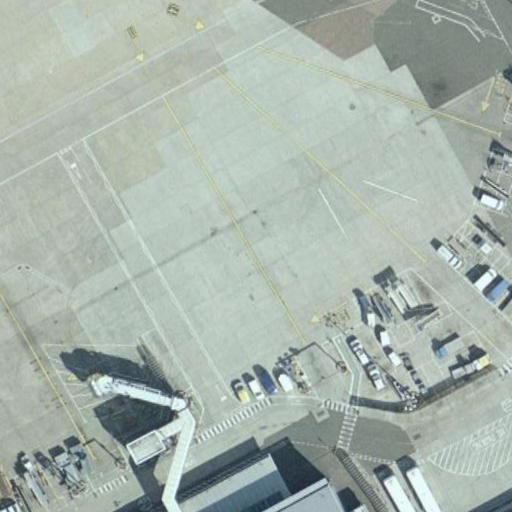

E:/datasets/DOTA_dataset_512/val/images/P1854_256.png
0.4
an aerial view of an airport with planes parked on the tarmac


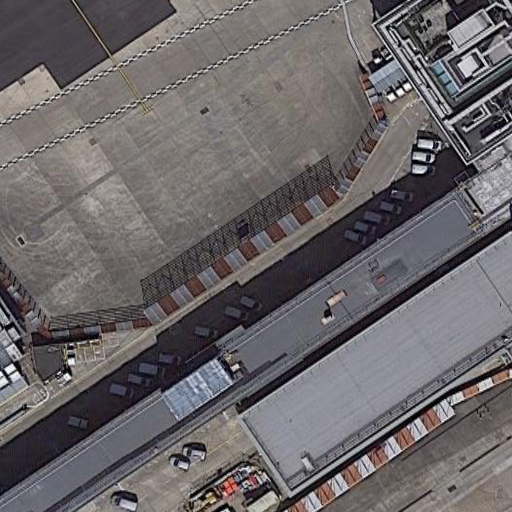

E:/datasets/DOTA_dataset_512/val/images/P1508_6.png
0.4
an aerial view of an airport with several planes parked on the tarmac


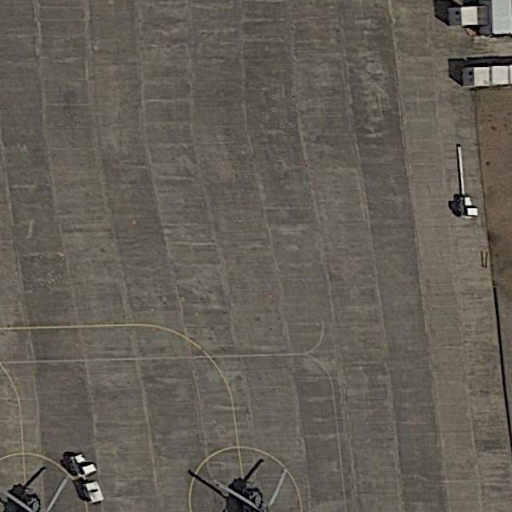

E:/datasets/DOTA_dataset_512/val/images/P2802_96.png
0.4
an aerial view of an airport with several planes parked on the tarmac


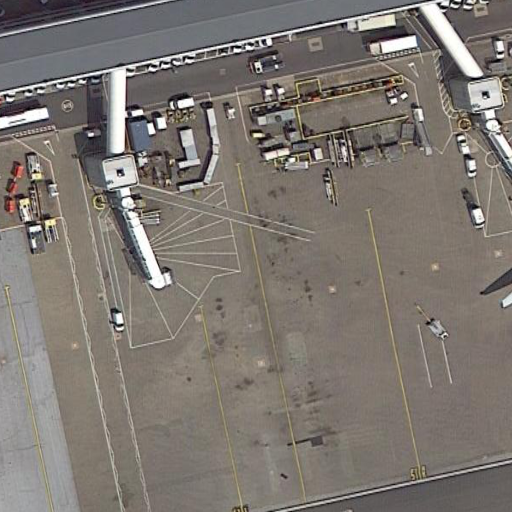

E:/datasets/DOTA_dataset_512/val/images/P2802_62.png
0.4
an aerial view of an airport with planes parked on the tarmac


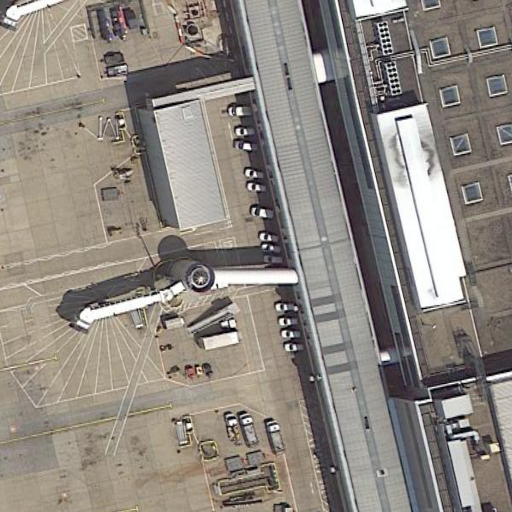

E:/datasets/DOTA_dataset_512/val/images/P0019_43.png
0.3
this is an aerial view of an airplane flying over the ocean


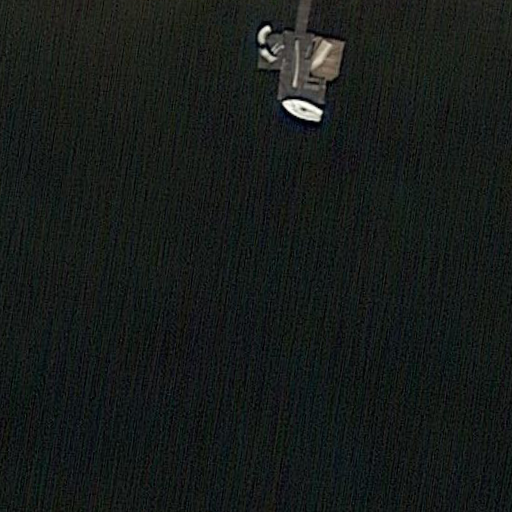

E:/datasets/DOTA_dataset_512/val/images/P1854_223.png
0.3
an aerial view of an airport with an airplane parked next to it


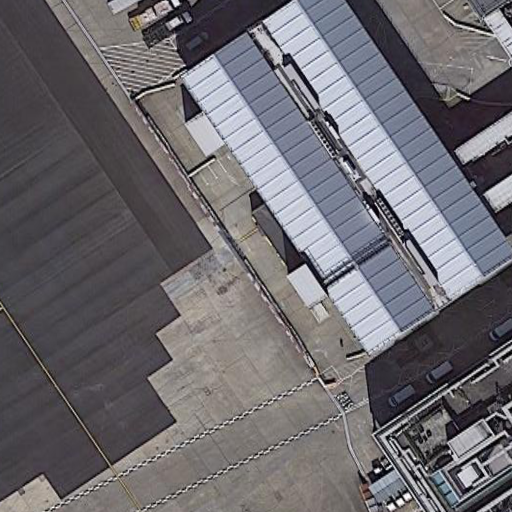

In [7]:
no_plane_context_df = context_df[(context_df['has_plane']==False)&(context_df['plane_score']>0.1)]
no_plane_context_df = no_plane_context_df.sort_values(by='plane_score',ascending=False)
no_plane_context_df.head(10)
print(len(no_plane_context_df.index))
for ind,  row in enumerate(no_plane_context_df.itertuples()):
    img = Image.open(row.image_path)
    print(row.image_path)
    print(row.plane_score)
    print(row.generated_text)
    display(img)
    if ind>5: break

272
['small-vehicle']
E:/datasets/DOTA_dataset_512/val/images/P2789_111.png
0.3
an aerial view of a ship docked at a dock


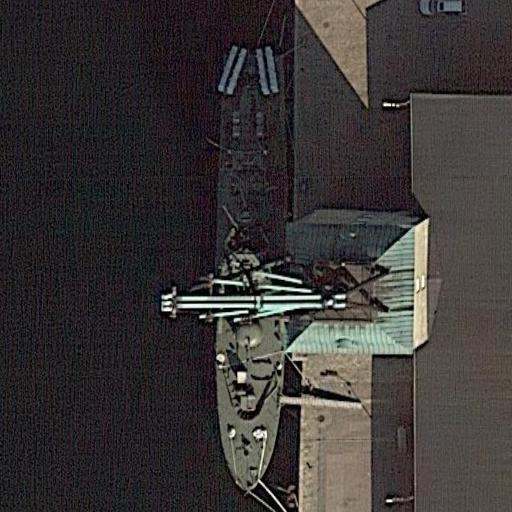

['small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0027_2.png
0.3
a satellite image of a lake with a boat in the water


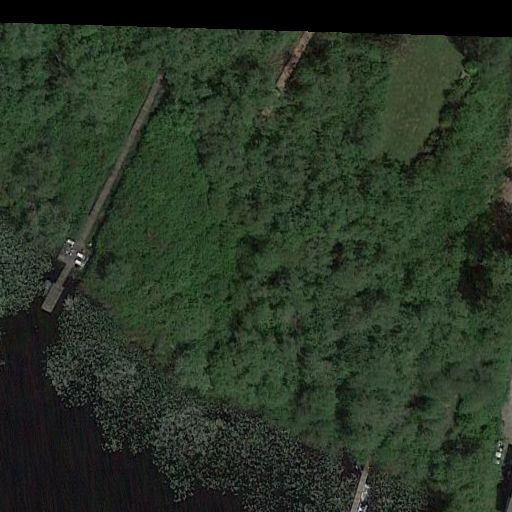

['small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1007_78.png
0.3
an aerial view of a boat dock in front of a body of water


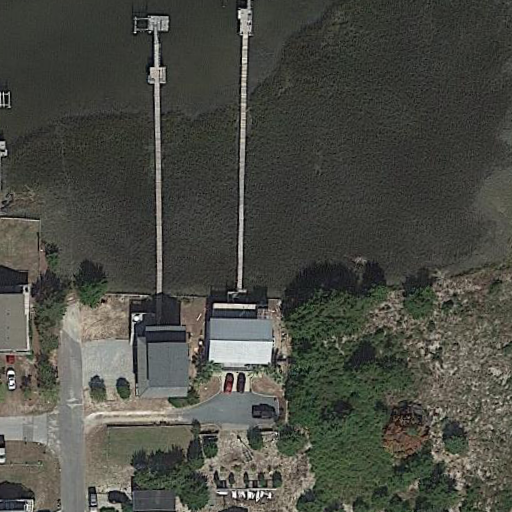

['harbor']
E:/datasets/DOTA_dataset_512/val/images/P0583_8.png
0.3
two boats are docked in the middle of a body of water


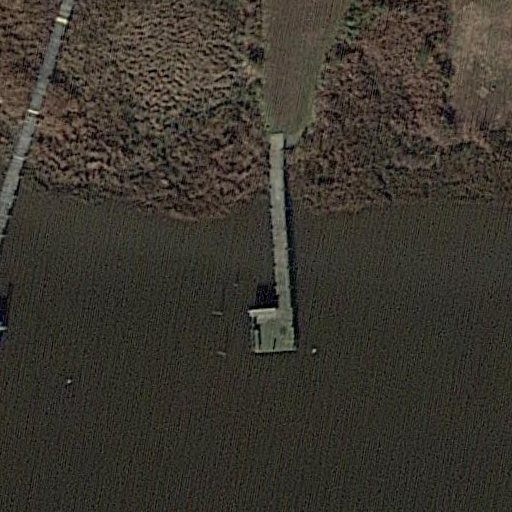

['small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1007_57.png
0.3
an aerial view of a boat dock in front of a body of water


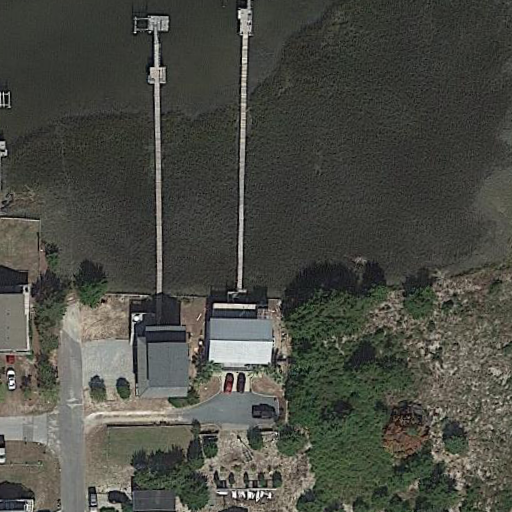

['harbor']
E:/datasets/DOTA_dataset_512/val/images/P1007_27.png
0.3
several small boats are docked in a body of water


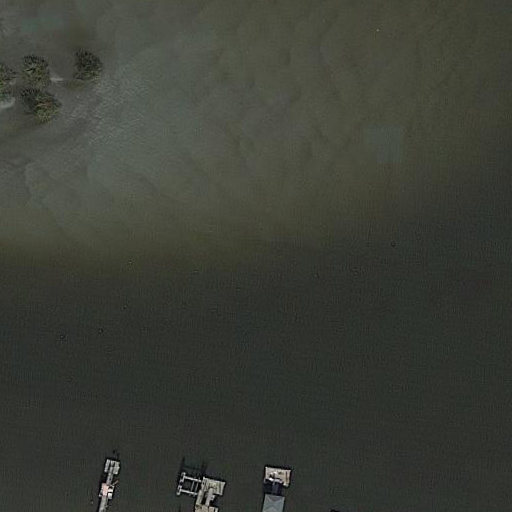

['small-vehicle']
E:/datasets/DOTA_dataset_512/val/images/P0259_28.png
0.3
an aerial view of a ship docked at a dock


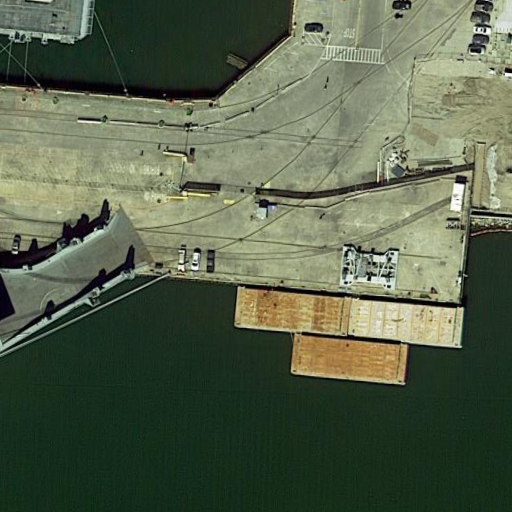

In [8]:
no_ship_context_df = context_df[(context_df['has_ship']==False)&(context_df['ship_score']>0.1)]
no_ship_context_df = no_ship_context_df.sort_values(by='ship_score',ascending=False)
no_ship_context_df.head(10)
print(len(no_ship_context_df.index))
for ind,  row in enumerate(no_ship_context_df.itertuples()):
    img = Image.open(row.image_path)
    print(row.category_list)
    print(row.image_path)
    print(row.ship_score)
    print(row.generated_text)
    display(img)
    if ind>5: break

521
['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0729_5.png
0.3
an aerial view of a marina with boats in the water


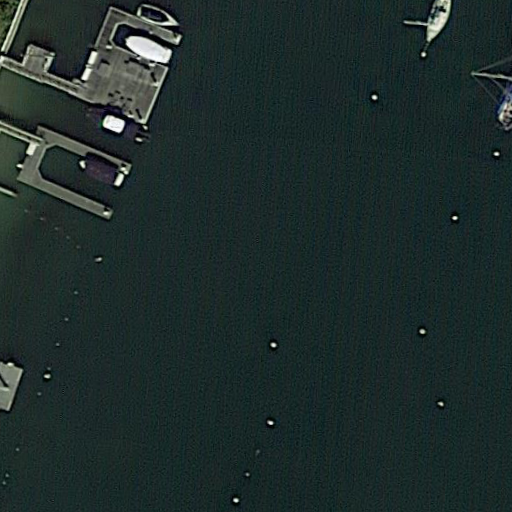

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1386_37.png
0.3
an aerial view of a marina with boats in the water


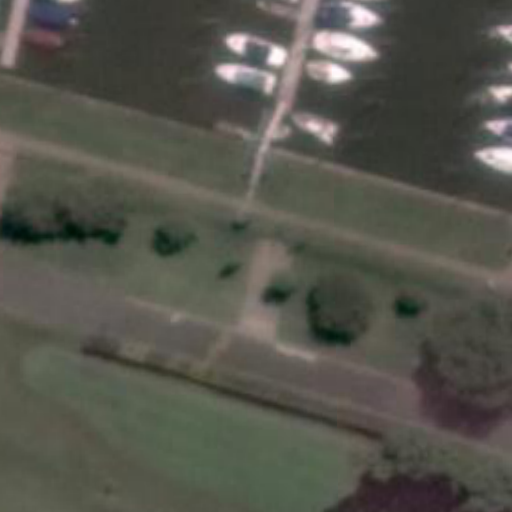

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0550_0.png
0.3
an aerial view of a lake with boats in the water


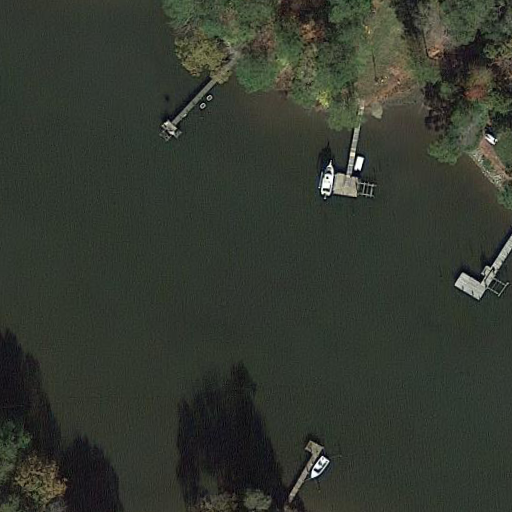

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0550_6.png
0.3
an aerial view of a house on a lake with boats in the water


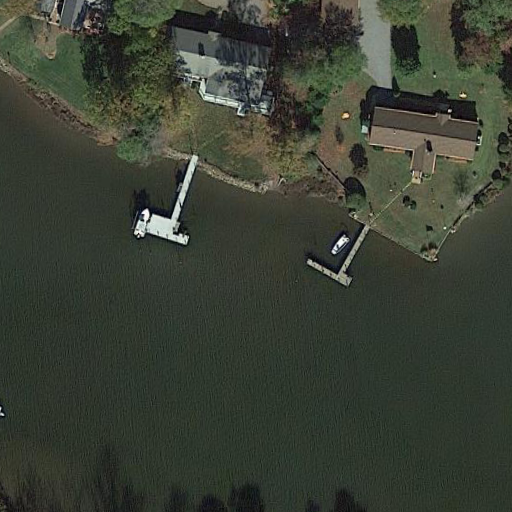

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0550_10.png
0.3
an aerial view of a house on a lake with boats in the water


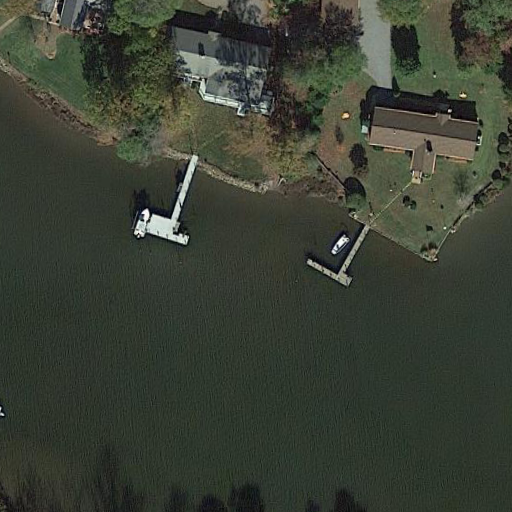

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1090_8.png
0.3
an aerial view of a marina with boats in the water


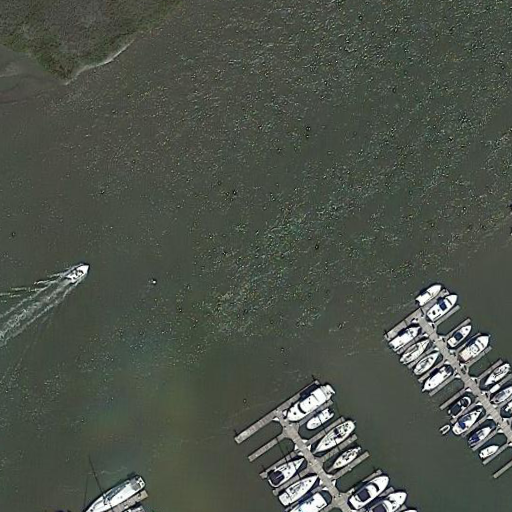

['swimming-pool', 'ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1075_53.png
0.3
an aerial view of a marina with boats in the water


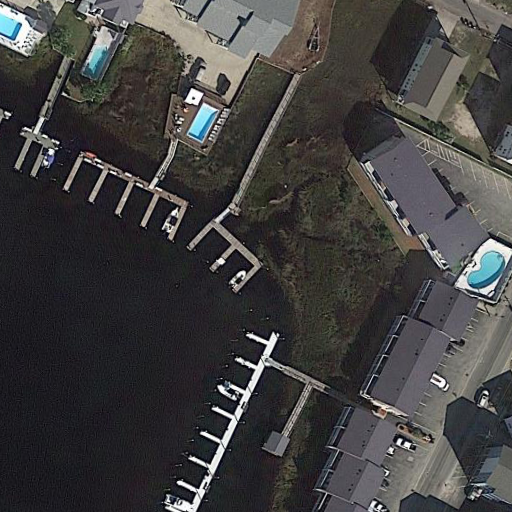

['swimming-pool', 'ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1075_52.png
0.3
an aerial view of a marina with boats in the water


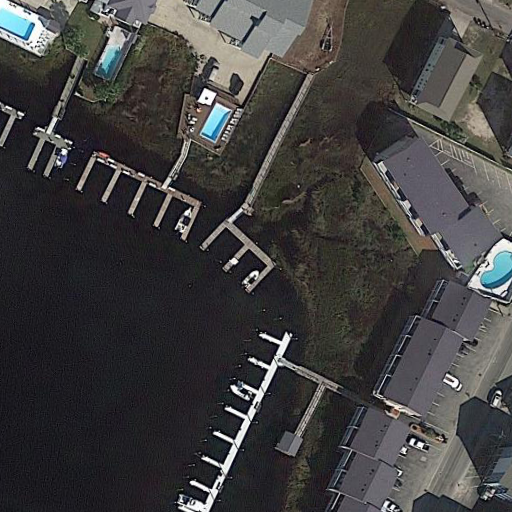

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0945_0.png
0.3
an aerial view of a marina with boats in the water


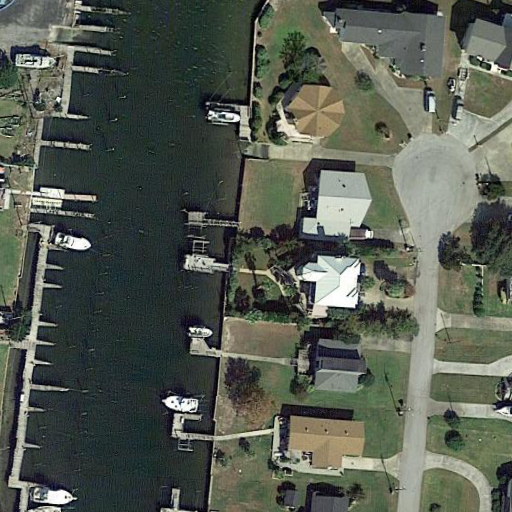

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P2059_4.png
0.3
an aerial view of a marina with boats in the water


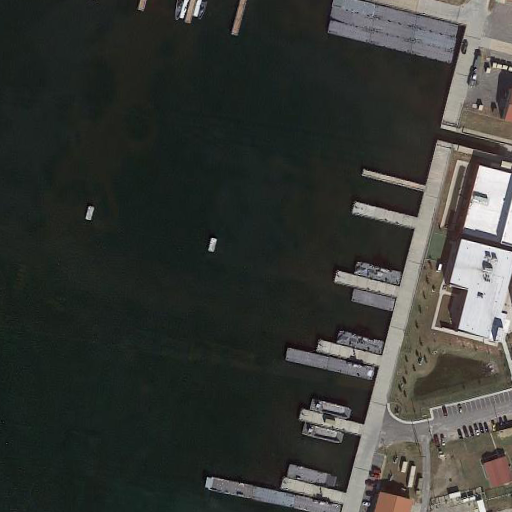

['swimming-pool', 'ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1075_3.png
0.3
an aerial view of a marina with boats in the water


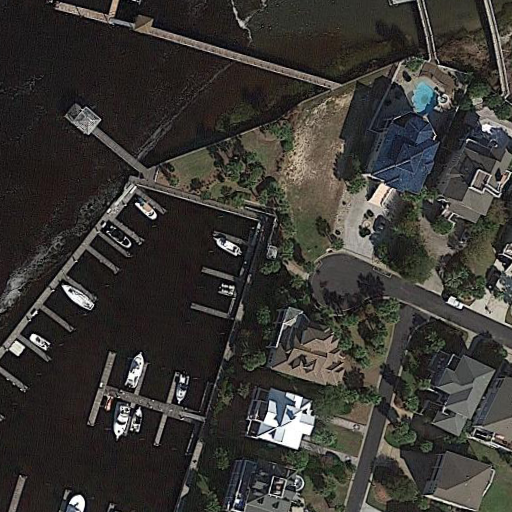

['harbor', 'ship', 'small-vehicle']
E:/datasets/DOTA_dataset_512/val/images/P0696_18.png
0.3
an aerial view of a marina with boats in the water


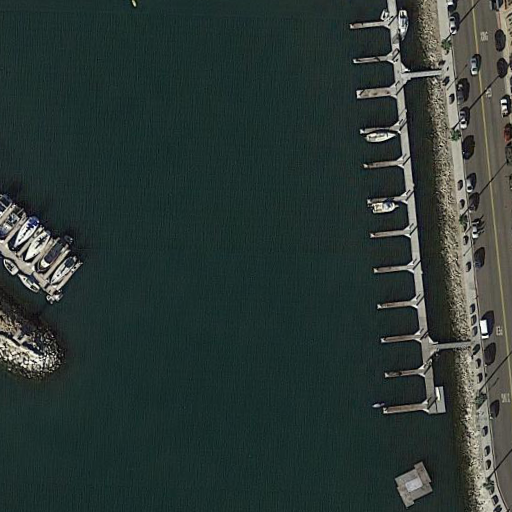

['harbor', 'ship', 'small-vehicle']
E:/datasets/DOTA_dataset_512/val/images/P0696_22.png
0.3
an aerial view of a marina with boats in the water


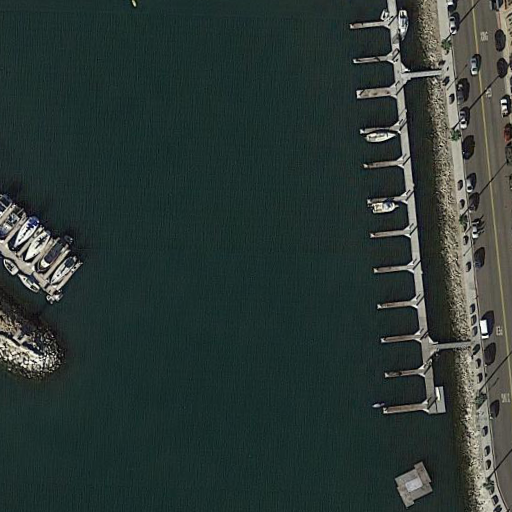

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0704_1.png
0.3
an aerial view of a marina with boats in the water


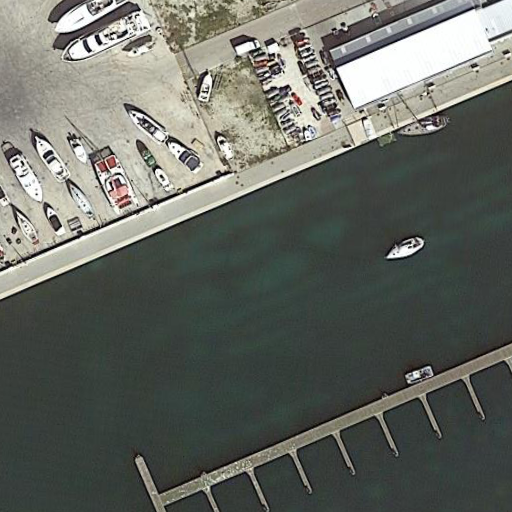

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P2059_5.png
0.3
an aerial view of a marina with boats in the water


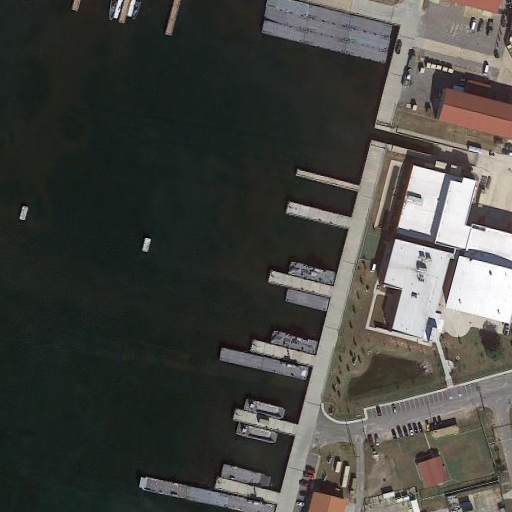

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0704_21.png
0.3
an aerial view of a marina with boats in the water


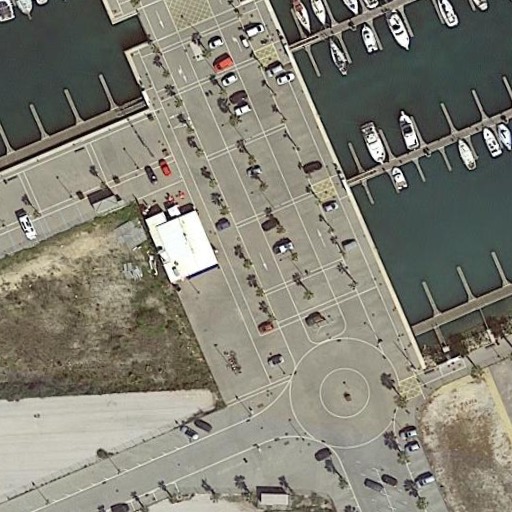

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0837_2.png
0.3
an aerial view of a marina with boats in the water


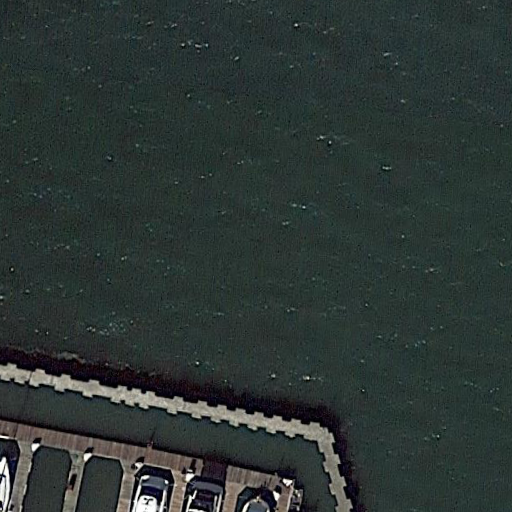

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0801_17.png
0.3
an aerial view of a marina with boats in the water


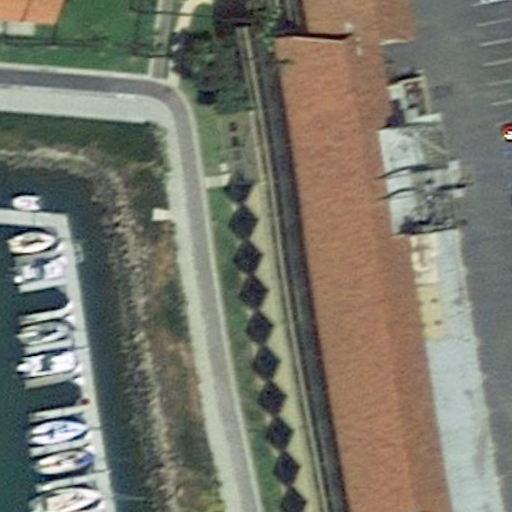

['swimming-pool', 'ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0715_5.png
0.3
an aerial view of a marina with boats in the water


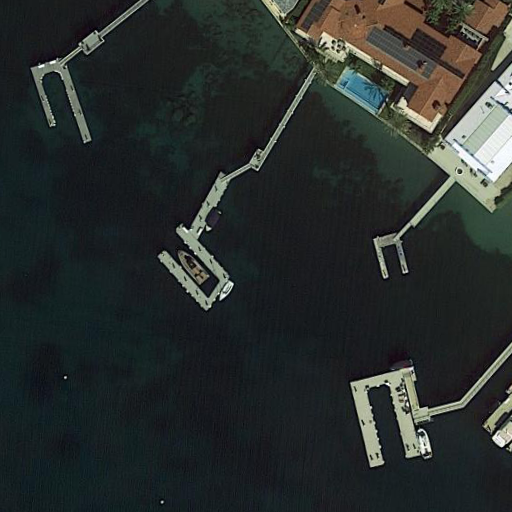

['swimming-pool', 'ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0715_6.png
0.3
an aerial view of a marina with boats in the water


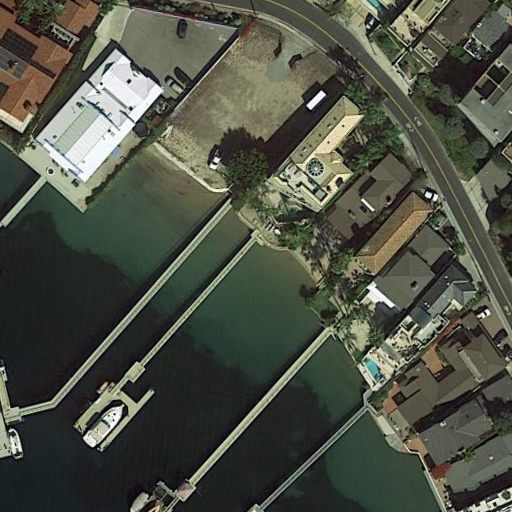

['swimming-pool', 'ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0715_7.png
0.3
an aerial view of a marina with boats in the water


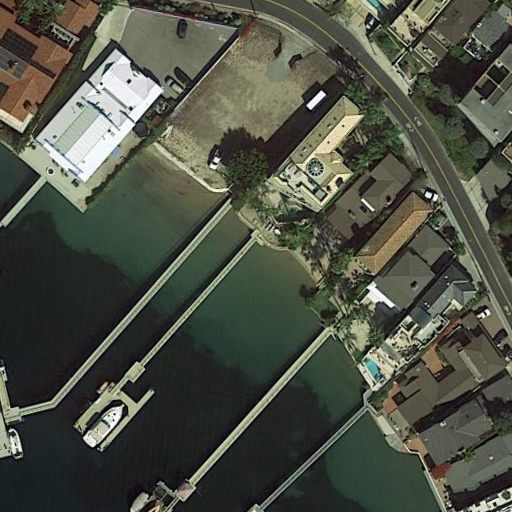

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0715_12.png
0.3
an aerial view of a marina with boats in the water


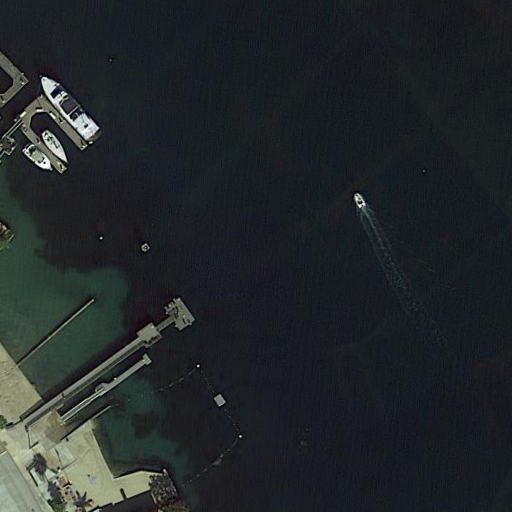

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0725_12.png
0.3
an aerial view of a marina with boats in the water


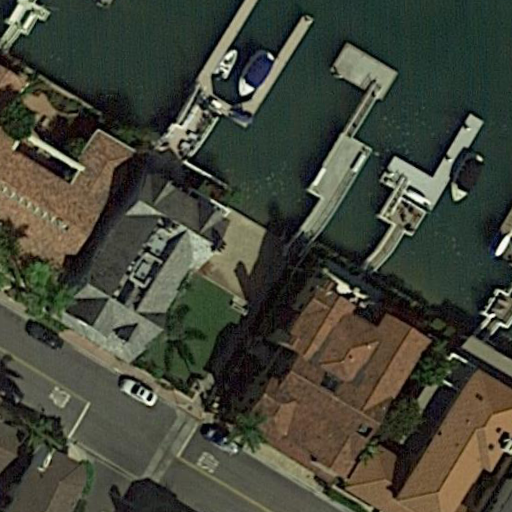

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0729_7.png
0.3
an aerial view of a marina with boats in the water


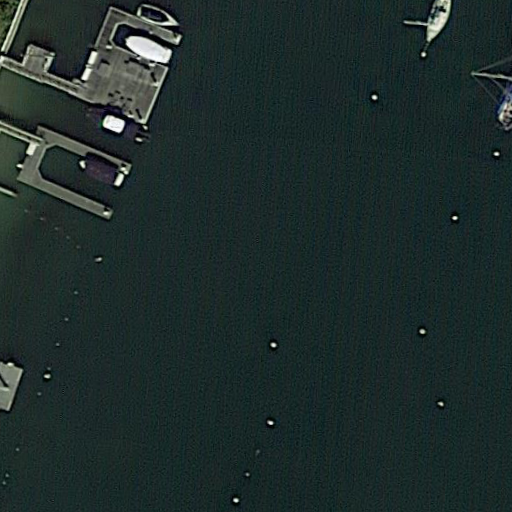

['harbor', 'ship', 'small-vehicle']
E:/datasets/DOTA_dataset_512/val/images/P0764_11.png
0.3
an aerial view of a marina with boats in the water


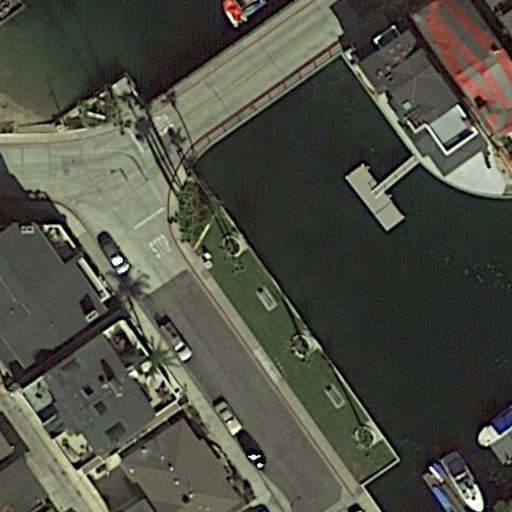

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1009_0.png
0.3
an aerial view of a marina with boats in the water


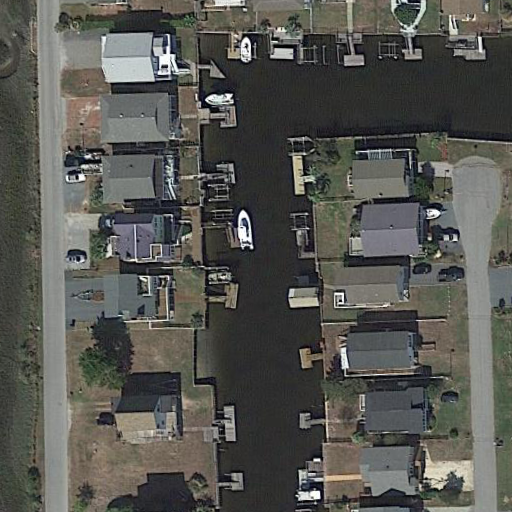

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1009_7.png
0.3
an aerial view of a marina with boats in the water


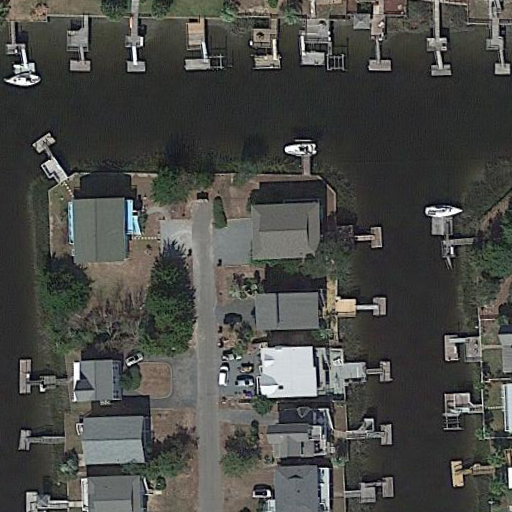

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1009_8.png
0.3
an aerial view of a marina with boats in the water


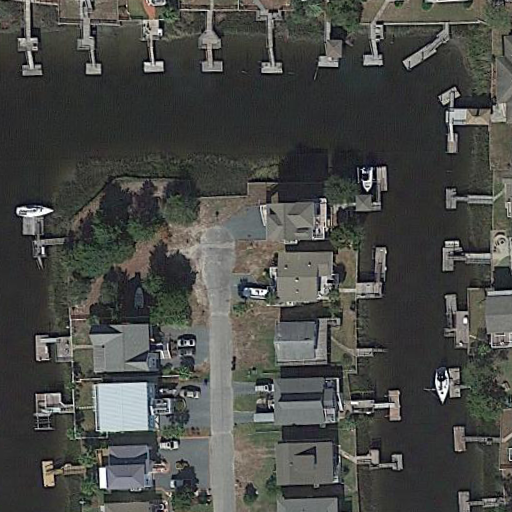

['ship', 'small-vehicle', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P1009_16.png
0.3
an aerial view of a marina with boats in the water


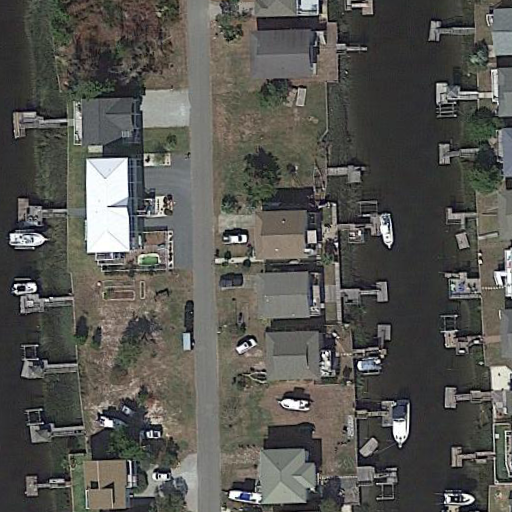

['ship', 'harbor']
E:/datasets/DOTA_dataset_512/val/images/P0910_7.png
0.3
an aerial view of a marina with boats in the water


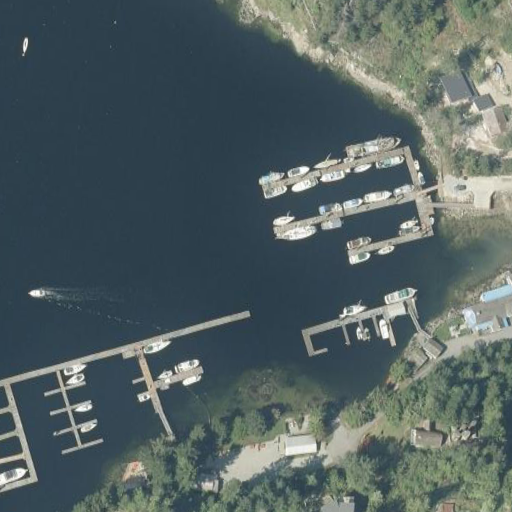

['harbor', 'ship', 'small-vehicle']
E:/datasets/DOTA_dataset_512/val/images/P1090_5.png
0.3
an aerial view of a marina with boats in the water


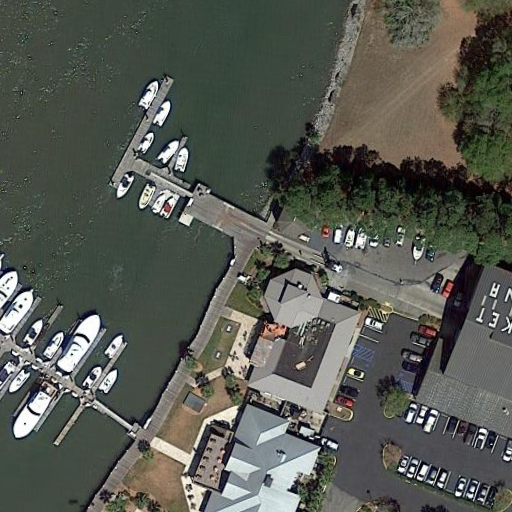

['ship', 'small-vehicle']
E:/datasets/DOTA_dataset_512/val/images/P0864_13.png
0.3
an aerial view of a marina with boats in the water


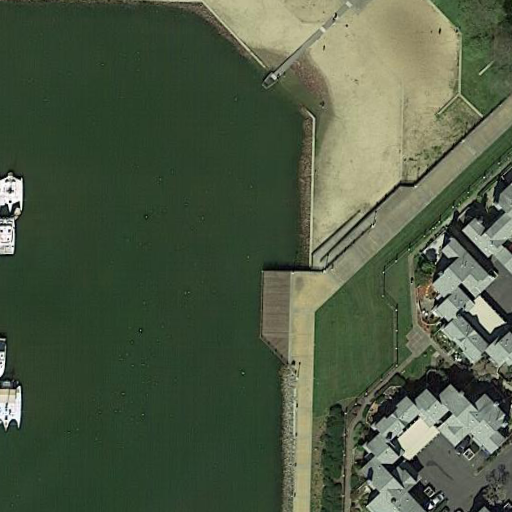

In [12]:
no_ship_context_df = context_df[(context_df['has_ship']==True)&(context_df['ship_score']>0.1)
                                &(~context_df['generated_text'].str.contains('dock'))
                                #&(context_df['generated_text'].str.contains('naval'))
                                &(~context_df['generated_text'].str.contains('houses'))]
no_ship_context_df = no_ship_context_df.sort_values(by='ship_score',ascending=False)
no_ship_context_df.head(10)
print(len(no_ship_context_df.index))
for ind,  row in enumerate(no_ship_context_df.itertuples()):
    img = Image.open(row.image_path)
    print(row.category_list)
    print(row.image_path)
    print(row.ship_score)
    print(row.generated_text)
    display(img)
    if ind>30: break